# Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
from collections import defaultdict

import scanpy as sc

from matplotlib.pyplot import rcParams
import matplotlib.pyplot as plt
import seaborn as sns

/home/icb/amirali.moinfar/miniconda3/envs/drvi_repr/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/home/icb/amirali.moinfar/miniconda3/envs/drvi_repr/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)
/home/icb/amirali.moinfar/miniconda3/envs/drvi_repr/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing read_excel from `anndata` is deprecated. Import anndata.io.read_excel instead.
  warnings.warn(msg, FutureWarning)
/home/icb/amirali.moinfar/miniconda3/envs/drvi_repr/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing read_mtx from `anndata` is deprecated. Import anndata.io.read_mtx instead.
  warnings.warn(msg, FutureWarning)
/home/icb/amirali.moinfar/miniconda3/e

In [3]:
import warnings
# warnings.filterwarnings(action='once')
warnings.filterwarnings('ignore')

In [4]:
import os

import scanpy as sc
import pandas as pd
import numpy as np
from pathlib import Path

from sklearn.feature_selection import mutual_info_regression
from scipy import stats

import drvi
from drvi_notebooks.utils.data.data_configs import get_data_info
from drvi_notebooks.utils.run_info import get_run_info_for_dataset
from drvi_notebooks.utils.method_info import pretify_method_name

Merlin is not installed. To use merline dataloader please install it.


In [5]:
sc.set_figure_params(vector_friendly=True, dpi_save=300)

In [6]:
import mplscience
mplscience.available_styles()
mplscience.set_style()

['default', 'despine']


# Config

In [7]:
cwd = os.getcwd()

In [8]:
logs_dir = Path(os.path.expanduser('~/workspace/train_logs'))
logs_dir

PosixPath('/home/icb/amirali.moinfar/workspace/train_logs')

In [9]:
proj_dir = Path(cwd).parent.parent
proj_dir

PosixPath('/ictstr01/home/icb/amirali.moinfar/projects/drvi_reproducibility_public')

In [10]:
output_dir = proj_dir / 'plots' / 'developmental_pancreas'
output_dir.mkdir(parents=True, exist_ok=True)
output_dir

PosixPath('/ictstr01/home/icb/amirali.moinfar/projects/drvi_reproducibility_public/plots/developmental_pancreas')

In [11]:
run_name = 'pancreas_scvelo'
run_version = '4.3'
run_path = os.path.expanduser('~/workspace/train_logs/models')

data_info = get_data_info(run_name, run_version)
wandb_address = data_info['wandb_address']
col_mapping = data_info['col_mapping']
plot_columns = data_info['plot_columns']
pp_function = data_info['pp_function']
data_path = data_info['data_path']
var_gene_groups = data_info['var_gene_groups']
cell_type_key = data_info['cell_type_key']
exp_plot_pp = data_info['exp_plot_pp']
control_treatment_key = data_info['control_treatment_key']
condition_key = data_info['condition_key']
split_key = data_info['split_key']

In [12]:
cat_10_pallete = sc.plotting.palettes.vega_10_scanpy
cat_10_pallete_without_grey = [c for c in cat_10_pallete if c != '#7f7f7f']
cat_20_pallete = sc.plotting.palettes.vega_20_scanpy
wong_pallete = [
    "#E69F00", "#56B4E9", "#009E73", "#F0E442", "#0072B2", "#D55E00", "#CC79A7", "#000000",
]
cat_100_pallete = sc.plotting.palettes.godsnot_102

## Utils

In [13]:
original_params = plt.rcParams.copy()
def set_font_in_rc_params(fs = 16):
    plt.rcParams.update({
        'font.size': fs,            # General font size
        'axes.titlesize': fs,      # Title font size
        'axes.labelsize': fs,      # Axis label font size
        'legend.fontsize': fs,    # Legend font size
        'xtick.labelsize': fs,      # X-axis tick label font size
        'ytick.labelsize': fs       # Y-axis tick label font size
    })

## Data

In [14]:
adata = sc.read(data_path)
adata

AnnData object with n_obs × n_vars = 3696 × 2000
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'velocity_pseudotime', 'latent_time', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'in_cr_data', 'clusters_fine', 'day', 'proliferation', 'phase', 'louvain_Alpha', 'louvain_Beta', 'palantir_pseudotime', 'macrostates_fwd', 'term_states_fwd', 'term_states_fwd_probs', 'clusters_gradients', 'cr_prob_fate_Alpha', 'cr_prob_fate_Beta', 'cr_prob_fate_Epsilon', 'cr_prob_fate_Delta'
    var: 'highly_variable_genes', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'log1p', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_umap'
    layers: 'all_norm_log1p', 'counts', 'scvelo_normalized', 'spliced', 'spliced_counts', 'spliced_norm_log1p', 'unspliced', 'unspliced_counts', 'unspliced_norm_log1p'
    obsp: 'connectivities', 'distances'

## Runs to load

In [15]:
run_info = get_run_info_for_dataset('pancreas_scvelo')
RUNS_TO_LOAD = run_info.run_dirs
scatter_point_size = run_info.scatter_point_size
adata_to_transfer_obs = run_info.adata_to_transfer_obs

for k,v in RUNS_TO_LOAD.items():
    if not os.path.exists(v):
        raise ValueError(f"{v} does not exists.")

In [16]:
embeds = {}
methods_to_consider = ["DRVI", "DRVI-IK", "scVI", "PCA", "ICA", "MICHIGAN-opt", "TCVAE-opt", "MOFA"]

random_order = None
for method_name, run_path in RUNS_TO_LOAD.items():
    if method_name not in methods_to_consider:
        continue
    print(method_name)
    if str(run_path).endswith(".h5ad"):
        embed = sc.read(run_path)
    else:
        embed = sc.read(run_path / 'latent.h5ad')
    pp_function(embed)
    if random_order is None:
        random_order = embed.obs.sample(frac=1.).index
    embed = embed[random_order].copy()
    embeds[method_name] = embed

DRVI
DRVI-IK
scVI
PCA
ICA
MOFA
TCVAE-opt
MICHIGAN-opt


In [17]:
new_cols = ['clusters_fine', 'cr_prob_fate_Alpha', 'cr_prob_fate_Beta', 'cr_prob_fate_Epsilon', 'cr_prob_fate_Delta']
col_mapping = {**col_mapping}
plot_columns = [*plot_columns]
col_mapping.update({
    'clusters_fine': 'Fine cell-type',
    'cr_prob_fate_Alpha': 'Alpha fate probability',
    'cr_prob_fate_Beta': 'Beta fate probability',
    'cr_prob_fate_Epsilon': 'Epsilon fate probability',
    'cr_prob_fate_Delta': 'Delta fate probability',
})
for col in new_cols:
    if col not in plot_columns:
        plot_columns.append(col)
for method_name, embed in embeds.items():
    for col in adata.obs.columns:
        if col not in embed.obs.columns:
            embed.obs[col] = adata.obs[col]

# UMAP plotting

In [18]:
_plot_columns = ['clusters_fine']
methods_to_plot = methods_to_consider

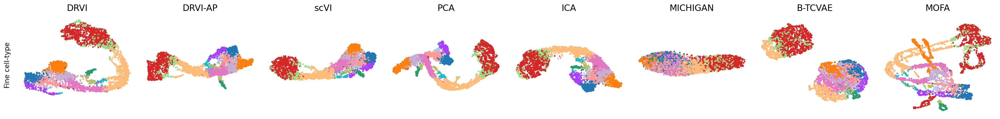

In [19]:
size = 3

for _, col in enumerate(_plot_columns):
    fig,axs=plt.subplots(1, len(methods_to_plot),
                     figsize=(len(methods_to_plot) * size, 1 * size),
                     sharey='row', squeeze=False)
    j = 0
    for i, method_name in enumerate(methods_to_plot):
        embed = embeds[method_name]
    
        pos = (-0.1, 0.5)
        
        ax = axs[j, i]
        unique_values = list(sorted(list(embed.obs[col].astype(str).unique())))
        # if len(unique_values) <= 8:
        #     palette = dict(zip(unique_values, wong_pallete))
        if len(unique_values) <= 10:
            palette = dict(zip(unique_values, cat_10_pallete))
        elif len(unique_values) <= 20:
            palette = dict(zip(unique_values, cat_20_pallete))
        elif len(unique_values) <= 102:
            palette = dict(zip(unique_values, cat_100_pallete))
        else:
            palette = None
        sc.pl.umap(embed, color=col, 
                   palette=palette, 
                   ax=ax, show=False, frameon=False, title='' if j != 0 else pretify_method_name(method_name), 
                   legend_loc='none' if i != len(methods_to_plot) - 1 or True else 'right margin',
                   colorbar_loc=None if i != len(methods_to_plot) - 1 else 'right')
        if i == 0:
            ax.annotate(col_mapping[col], zorder=100, fontsize=12,
                        xy=pos, xytext=pos, textcoords='axes fraction', rotation='vertical', va='center', ha='center')

    plt.subplots_adjust(left=0.1,
                        bottom=0.05,
                        right=0.95,
                        top=0.95,
                        wspace=0.1,
                        hspace=0.1)   
    plt.tight_layout()
    dir_name = output_dir
    dir_name.mkdir(parents=True, exist_ok=True)
    fig.savefig(dir_name / f"umaps_{col}.pdf", bbox_inches='tight')
    plt.show()

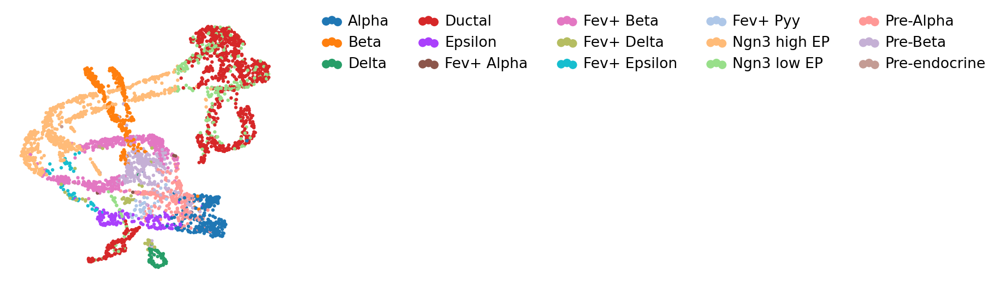

In [20]:
# This cell is just to make a palette for publication
col = 'clusters_fine'
unique_values = list(sorted(list(embed.obs[col].astype(str).unique())))
palette = dict(zip(unique_values, cat_20_pallete))
fig = sc.pl.umap(embed, color=col, palette=palette, show=False, frameon=False, title='', 
                   legend_loc='right margin')
plt.legend(ncol=(len(unique_values) + 2) // 3, bbox_to_anchor=(1.1, 1.05))
dir_name = output_dir
dir_name.mkdir(parents=True, exist_ok=True)
plt.savefig(dir_name / f'umaps_{col}_legend.pdf', bbox_inches='tight', dpi=300)
plt.show()

# DRVI interpretability

In [21]:
embed = embeds['DRVI']
model = drvi.model.DRVI.load(RUNS_TO_LOAD['DRVI'] / 'model.pt', adata, prefix='v_0_1_0_')
adata.obsm['X_umap_drvi'] = embed[adata.obs.index].obsm['X_umap']

INFO     File                                                                                                      
         /home/icb/amirali.moinfar/workspace/train_logs/models/drvi_20240410-194324-973593/model.pt/v_0_1_0_model.p
         t already downloaded                                                                                      


An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


INFO     DRVI: The model has been initialized                                                                      


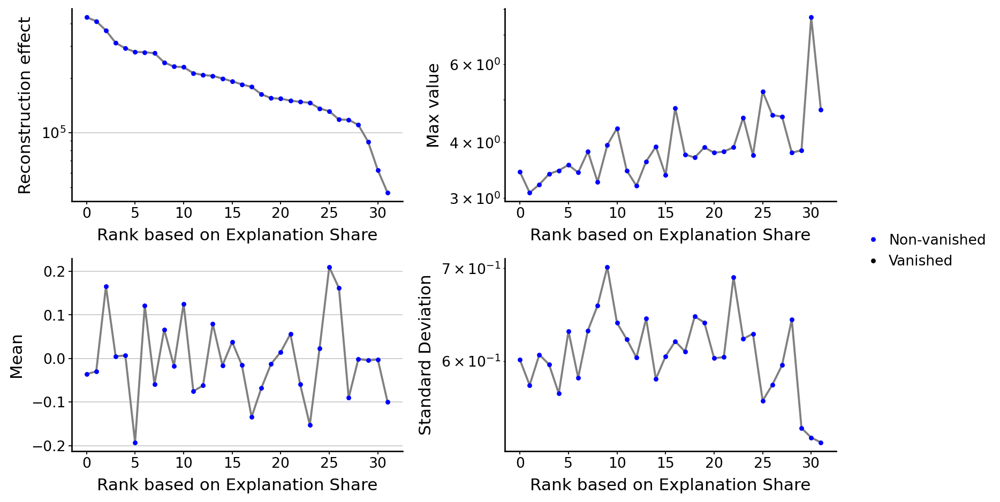

In [22]:
drvi.utils.tl.set_latent_dimension_stats(model, embed)
drvi.utils.pl.plot_latent_dimension_stats(embed, ncols=2)

In [23]:
filename = RUNS_TO_LOAD['DRVI'] / "traverse_adata.h5ad"
if not (filename).exists():
    traverse_adata = drvi.utils.tl.traverse_latent(model, embed, n_samples=200, max_noise_std=0.2)
    drvi.utils.tl.calculate_differential_vars(traverse_adata)
    traverse_adata.write(filename)
else:
    traverse_adata = sc.read(filename)
traverse_adata

AnnData object with n_obs × n_vars = 128000 × 2000
    obs: 'original_order', 'dim_id', 'sample_id', 'step_id', 'span_value', 'lib_size', 'title', 'vanished', 'order'
    var: 'original_order'
    uns: 'combined_score_traverse_effect_neg_dim_ids', 'combined_score_traverse_effect_pos_dim_ids', 'combined_score_traverse_effect_stepwise', 'max_possible_traverse_effect_neg_dim_ids', 'max_possible_traverse_effect_pos_dim_ids', 'max_possible_traverse_effect_stepwise', 'min_possible_traverse_effect_neg_dim_ids', 'min_possible_traverse_effect_pos_dim_ids', 'min_possible_traverse_effect_stepwise'
    obsm: 'control_latent', 'effect_latent'
    varm: 'combined_score_traverse_effect_neg', 'combined_score_traverse_effect_pos', 'max_possible_traverse_effect_neg', 'max_possible_traverse_effect_pos', 'min_possible_traverse_effect_neg', 'min_possible_traverse_effect_pos'
    layers: 'control', 'effect'

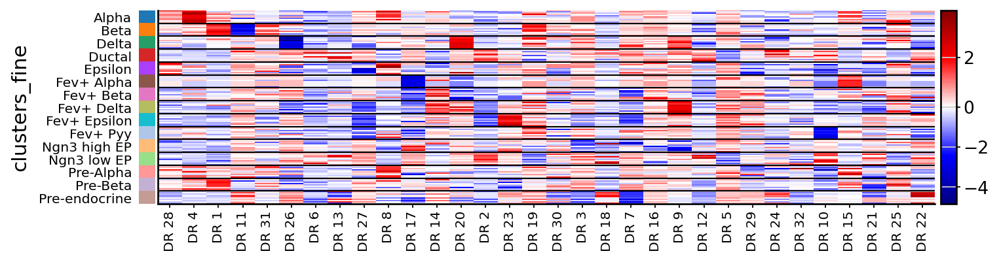

In [24]:
drvi.utils.pl.plot_latent_dims_in_heatmap(embed, "clusters_fine", title_col="title", sort_by_categorical=True)

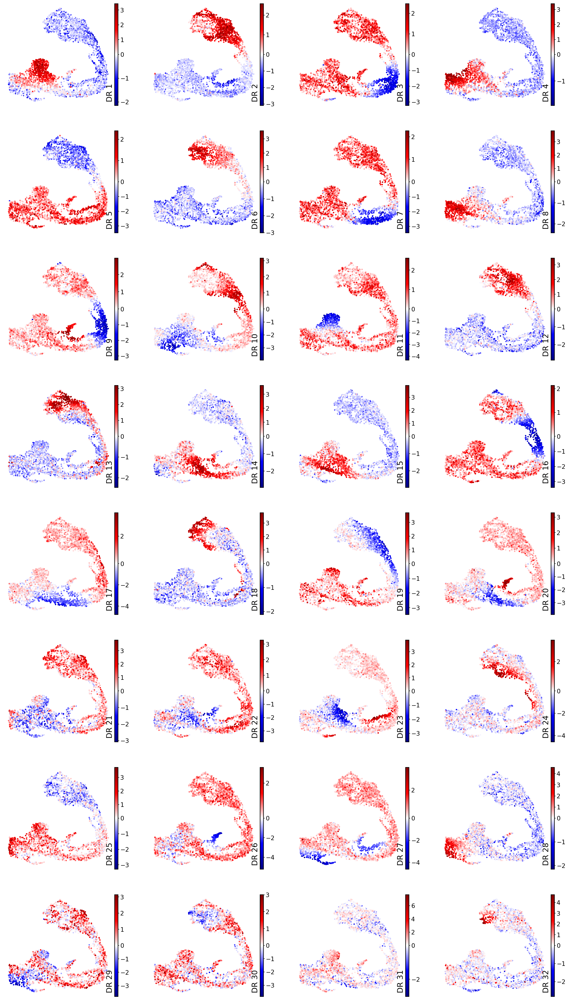

In [25]:
drvi.utils.pl.plot_latent_dims_in_umap(embed, directional=False)

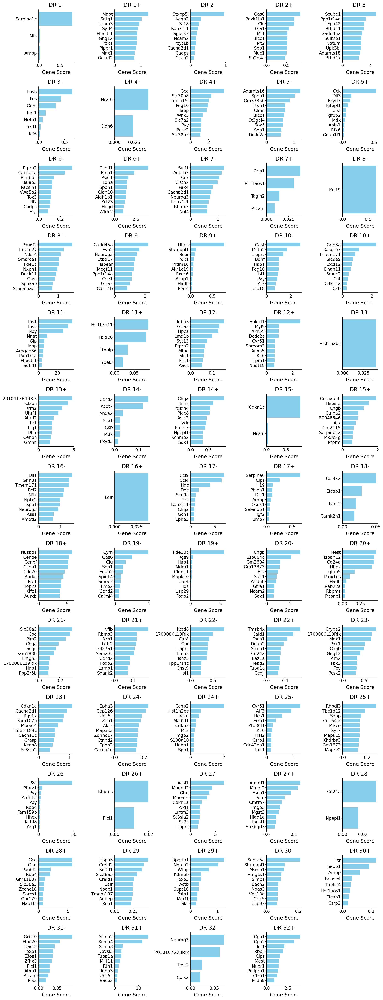

In [26]:
drvi.utils.pl.show_top_differential_vars(traverse_adata, key="combined_score", score_threshold=0.0)

Alpha


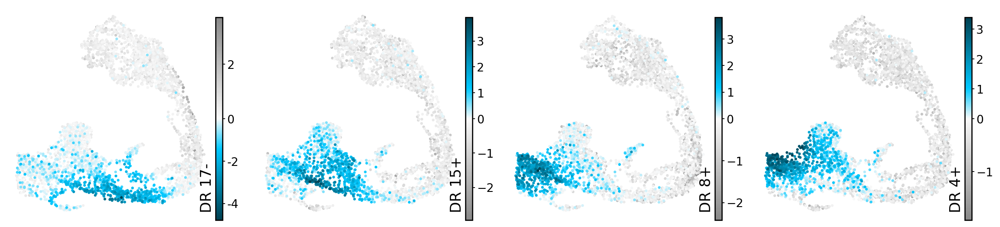

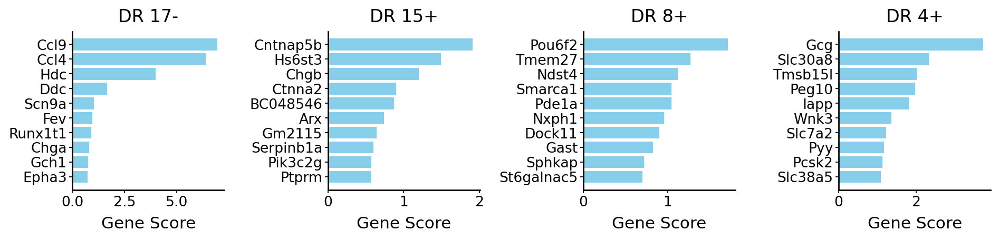

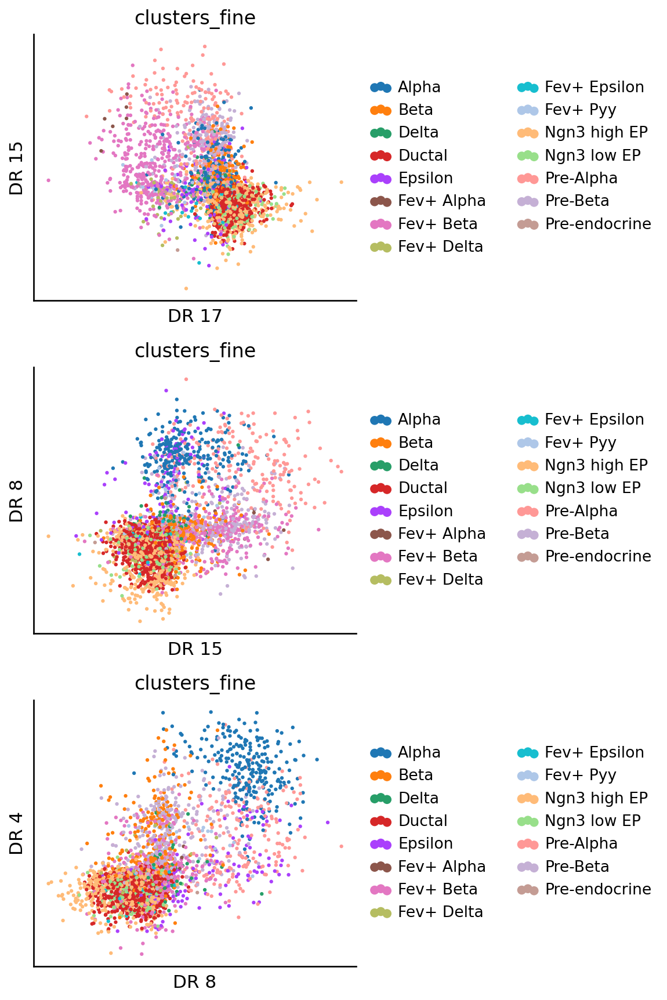

Beta


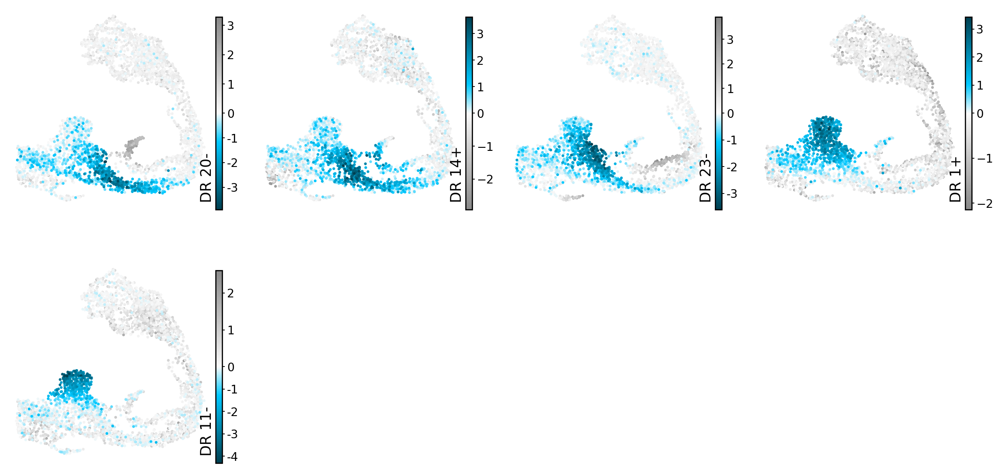

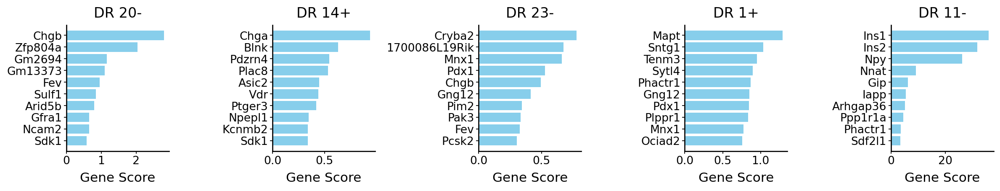

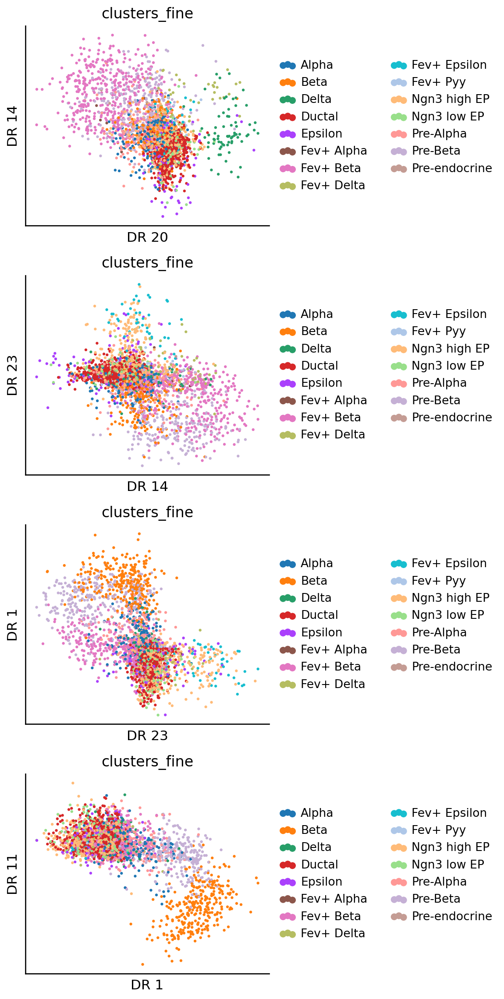

Epsilon


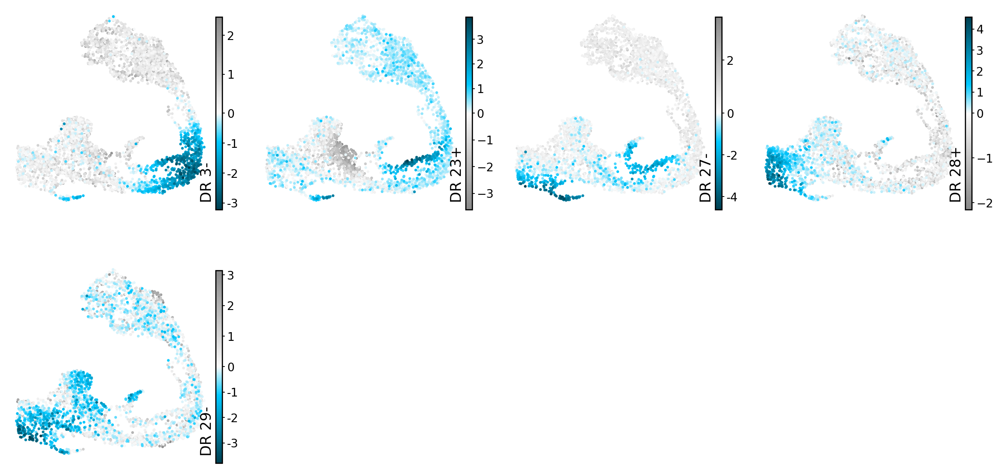

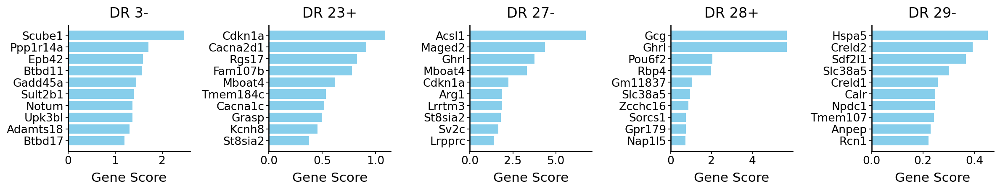

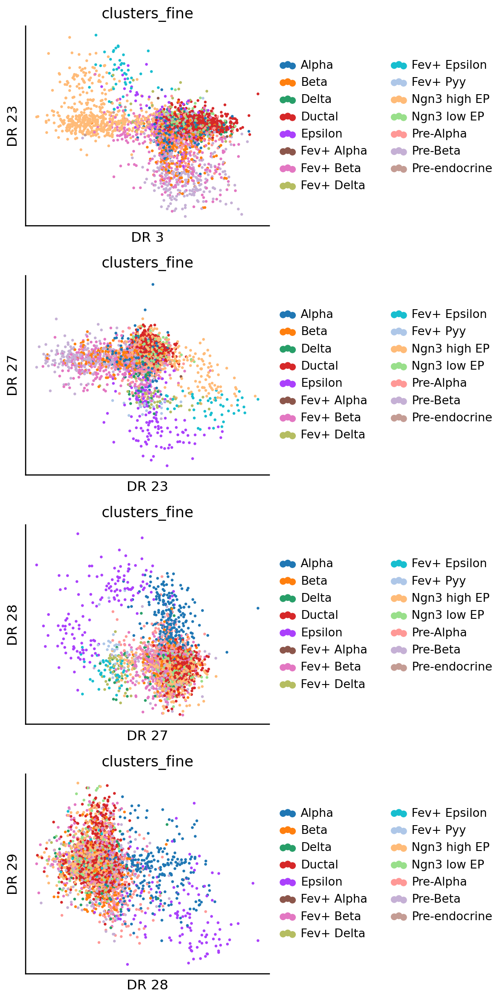

Delta


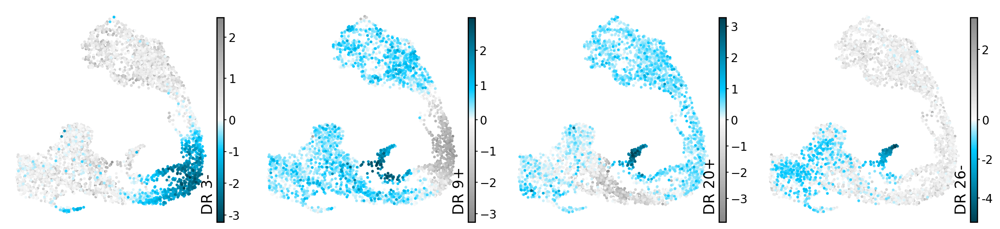

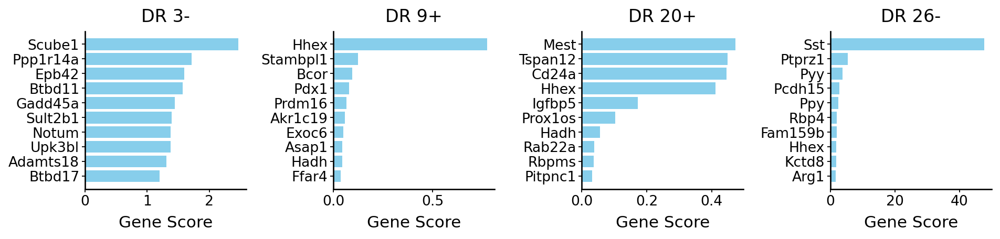

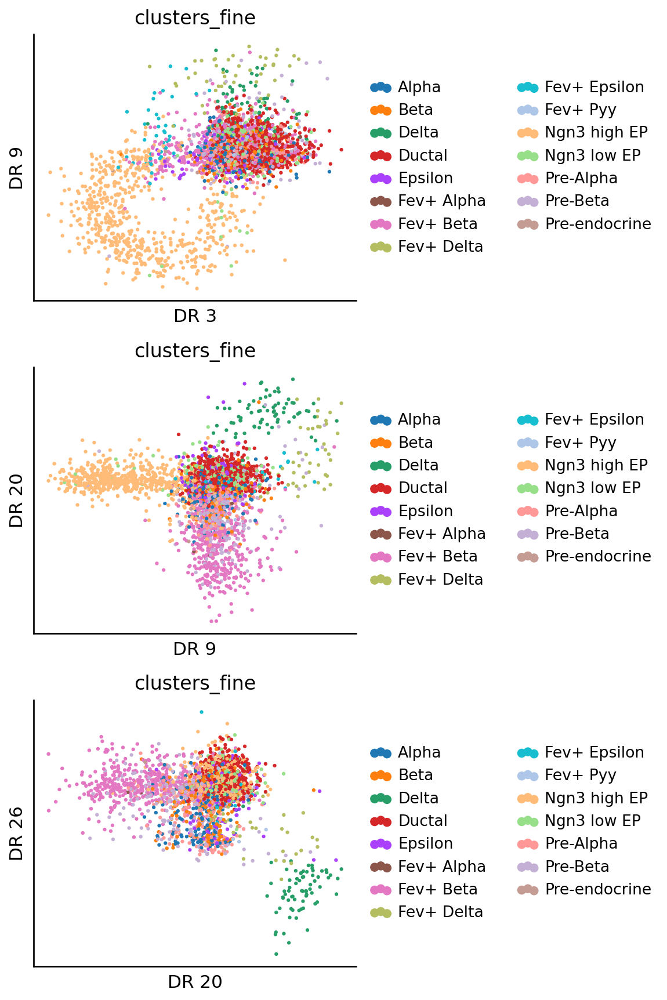

In [27]:
relevant_dims = [
    (['DR 17-', 'DR 15+', 'DR 8+', 'DR 4+'], "Alpha"),
    (['DR 20-', 'DR 14+', 'DR 23-', 'DR 1+', 'DR 11-'], "Beta"),
    (['DR 3-',  'DR 23+', 'DR 27-', 'DR 28+', 'DR 29-'], "Epsilon"),
    (['DR 3-', 'DR 9+', 'DR 20+', 'DR 26-'], "Delta"),
]
for dims, title in relevant_dims:
    print(title)
    fig = drvi.utils.pl.plot_latent_dims_in_umap(embed, directional=True, ncols=4, show=False, wspace=0.1, hspace=0.25, color_bar_rescale_ratio=0.95,
                                                 dim_subset=dims)
    plt.show()
    
    drvi.utils.pl.show_top_differential_vars(traverse_adata, dim_subset=dims, key="combined_score", score_threshold=0.0)

    dim_pairs = [
        (int(np.argmax(embed.var['title'] == d1[:-1])), int(np.argmax(embed.var['title'] == d2[:-1]))) for d1, d2 in zip(dims[:-1], dims[1:])
    ]
    fig = sc.pl.embedding(embed, 'qz_mean', dimensions=dim_pairs, return_fig=True, color=['clusters_fine'], ncols=1, show=False)
    for ax in fig.axes:
        xlbl = str(ax.xaxis.get_label().get_text())
        ylbl = str(ax.yaxis.get_label().get_text())
        # print(xlbl, ylbl)
        if 'qz_mean' in xlbl:
            ax.set_xlabel(embed.var.iloc[int(xlbl.split('qz_mean')[-1])-1]['title'])
        if 'qz_mean' in ylbl:
            ax.set_ylabel(embed.var.iloc[int(ylbl.split('qz_mean')[-1])-1]['title'])
    plt.show()

Alpha


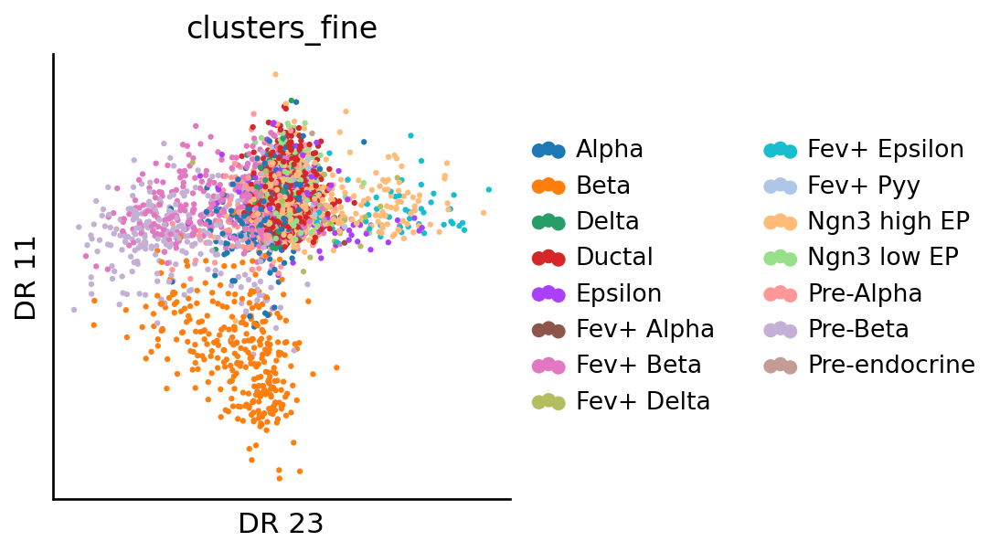

Beta


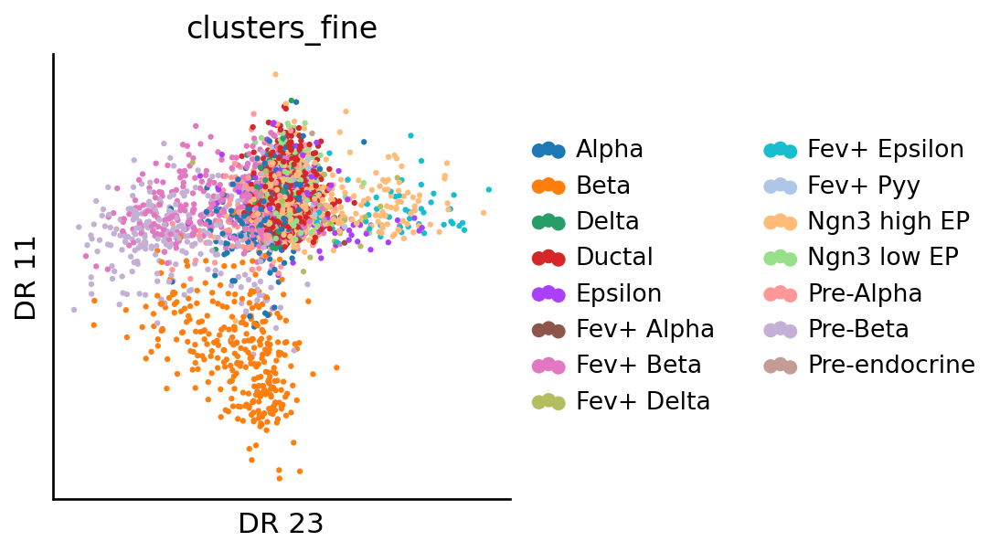

Epsilon


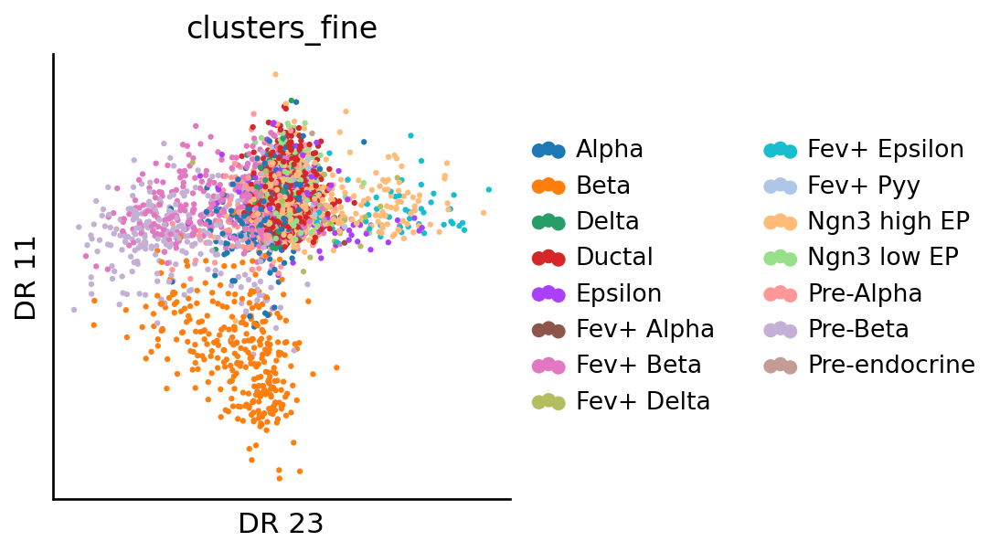

Delta


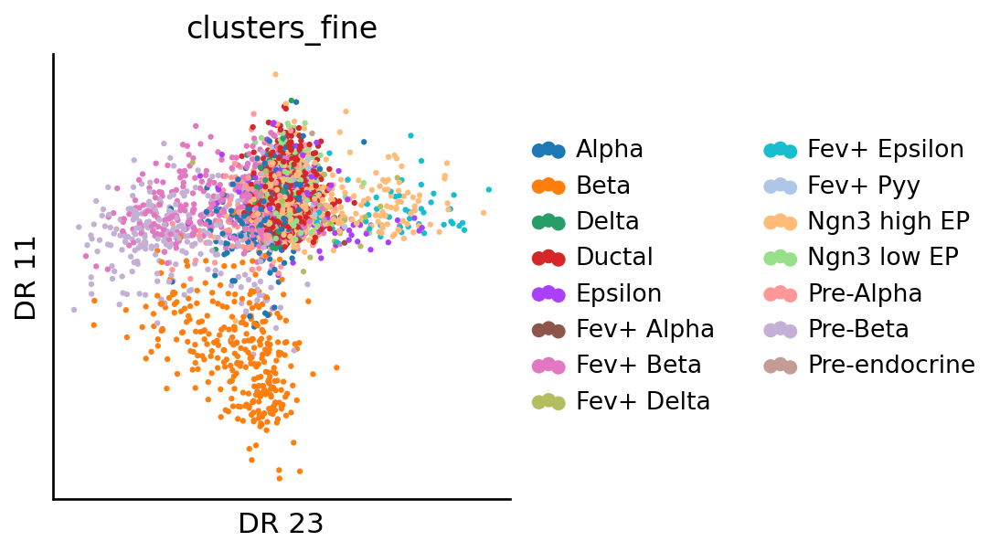

In [28]:
for dims, title in relevant_dims:
    print(title)
    dim_pairs = [
            (int(np.argmax(embed.var['title'] == 'DR 23')), int(np.argmax(embed.var['title'] == 'DR 11')))
    ]
    fig = sc.pl.embedding(embed, 'qz_mean', dimensions=dim_pairs, return_fig=True, color=['clusters_fine'], ncols=1, show=False)
    for ax in fig.axes:
        xlbl = str(ax.xaxis.get_label().get_text())
        ylbl = str(ax.yaxis.get_label().get_text())
        # print(xlbl, ylbl)
        if 'qz_mean' in xlbl:
            ax.set_xlabel(embed.var.iloc[int(xlbl.split('qz_mean')[-1])-1]['title'])
        if 'qz_mean' in ylbl:
            ax.set_ylabel(embed.var.iloc[int(ylbl.split('qz_mean')[-1])-1]['title'])
    plt.show()

Alpha


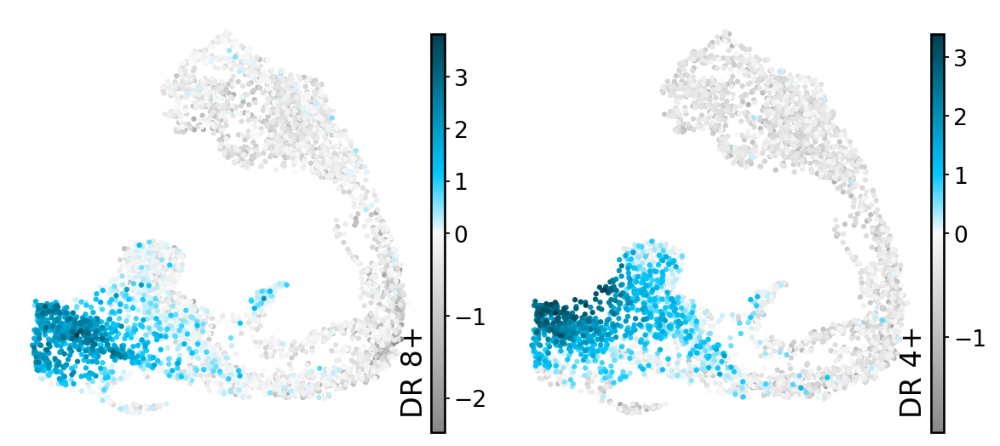

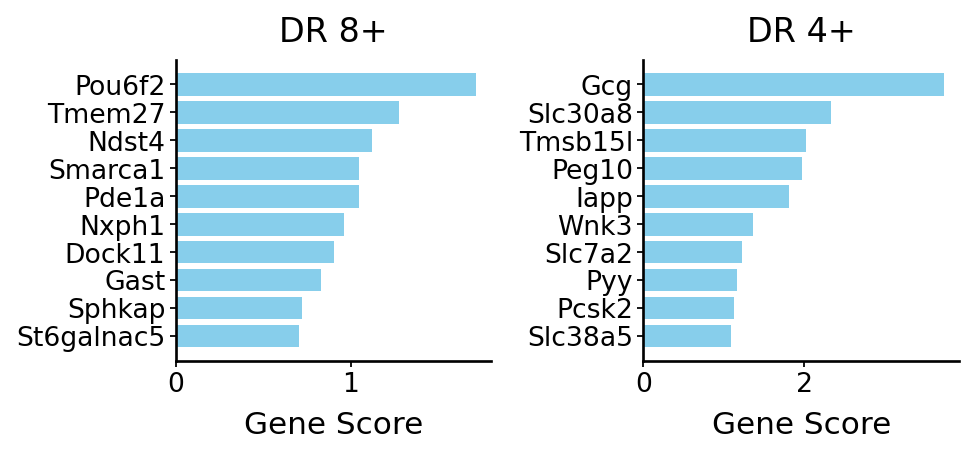

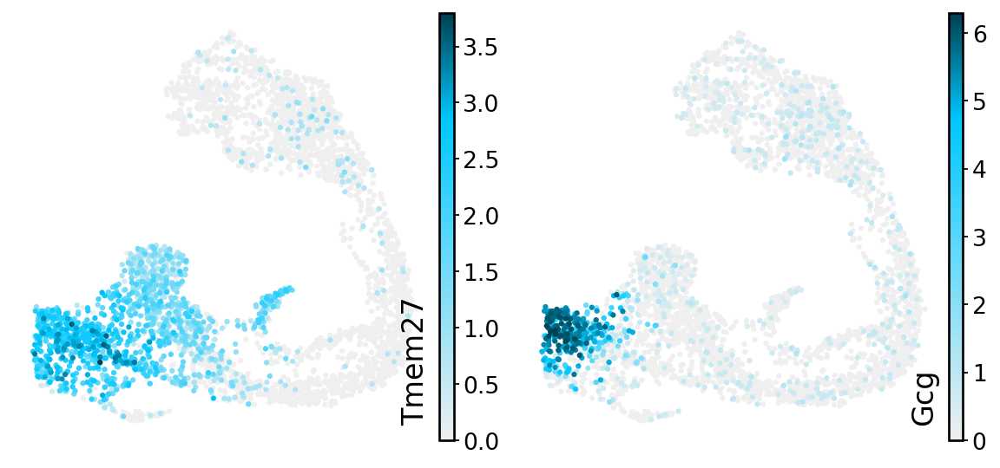

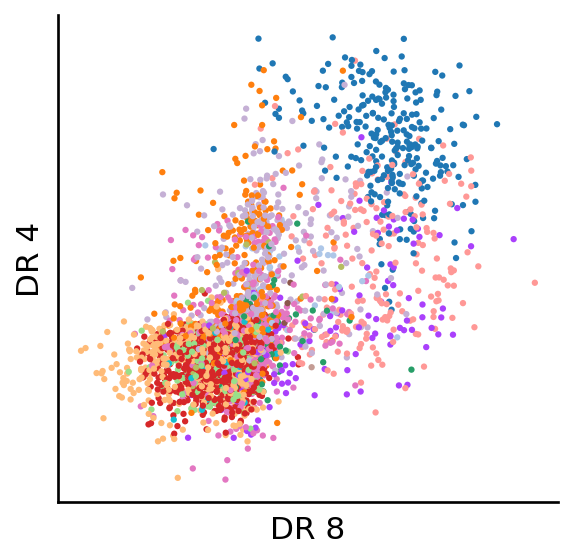

Beta


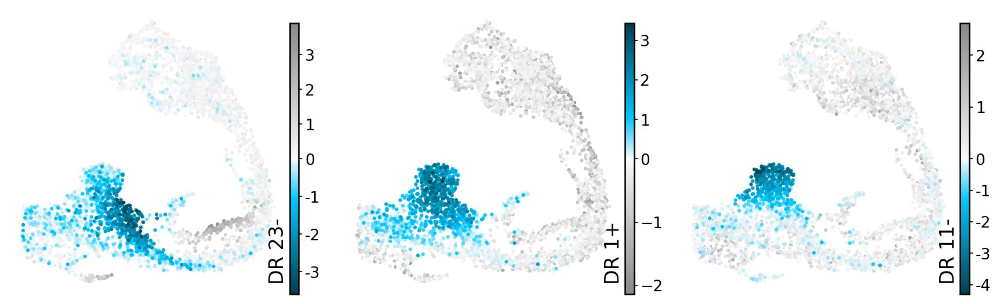

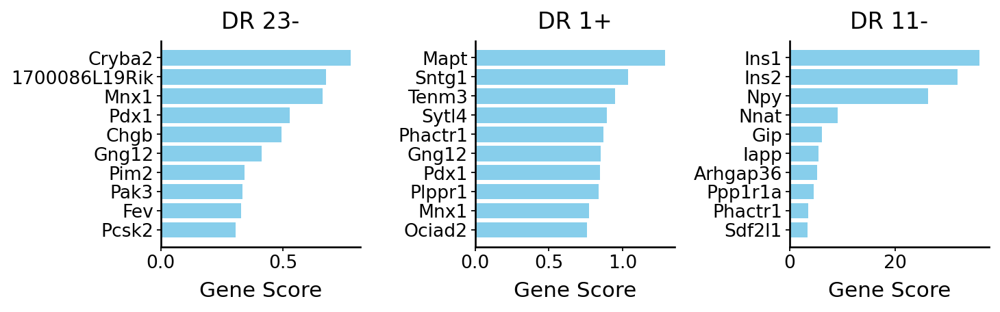

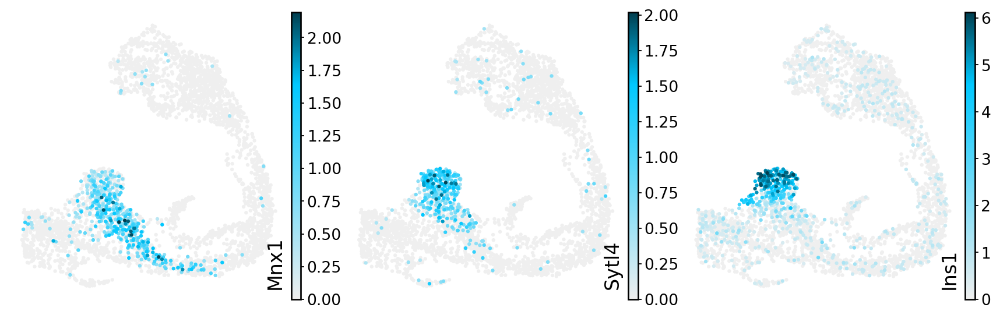

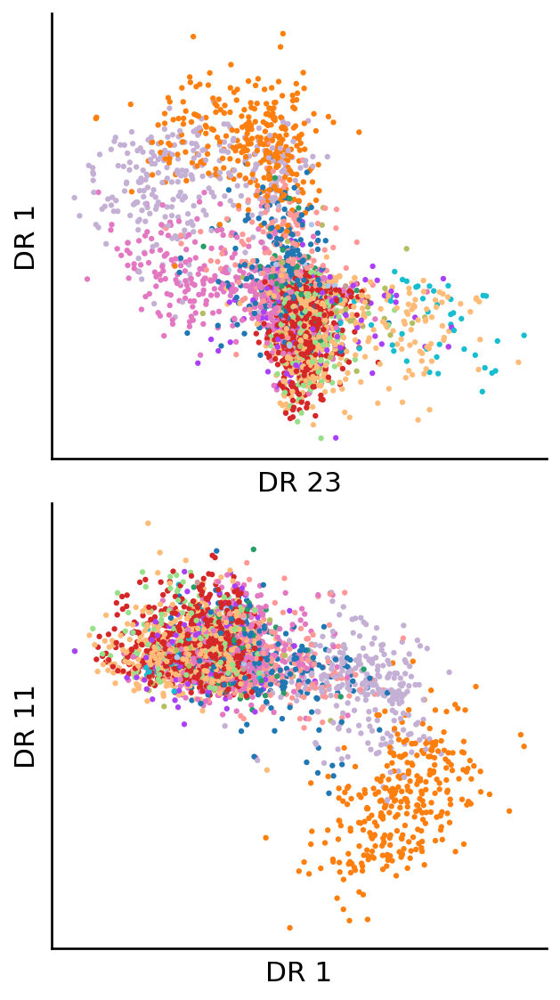

Epsilon


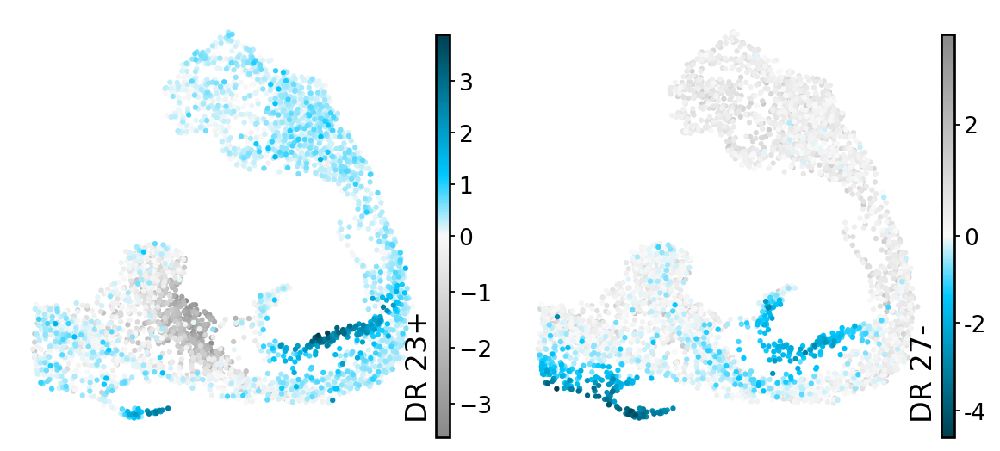

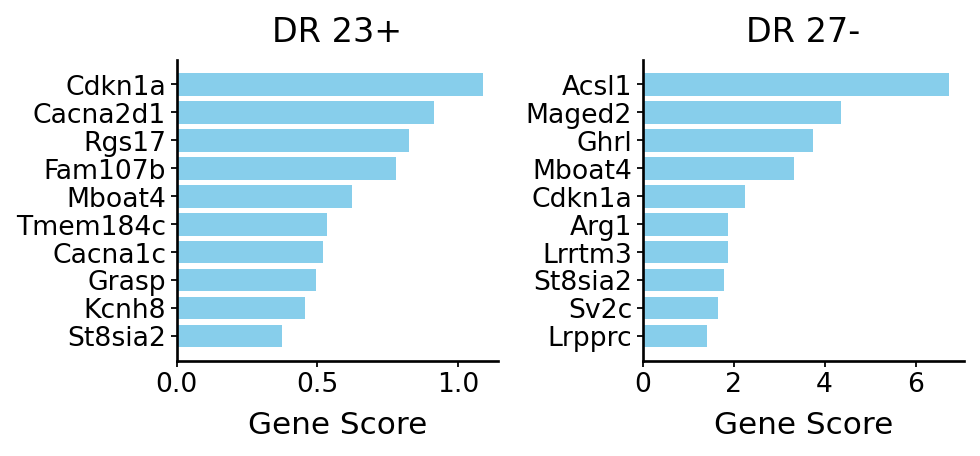

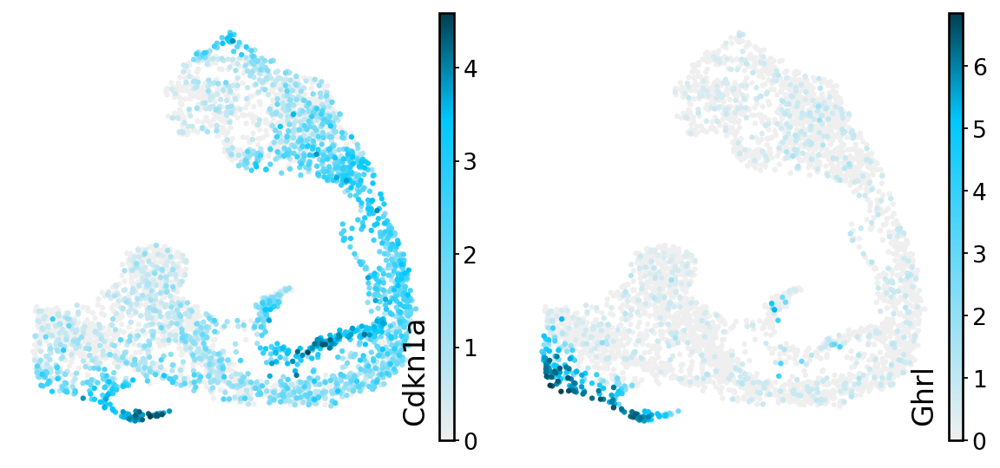

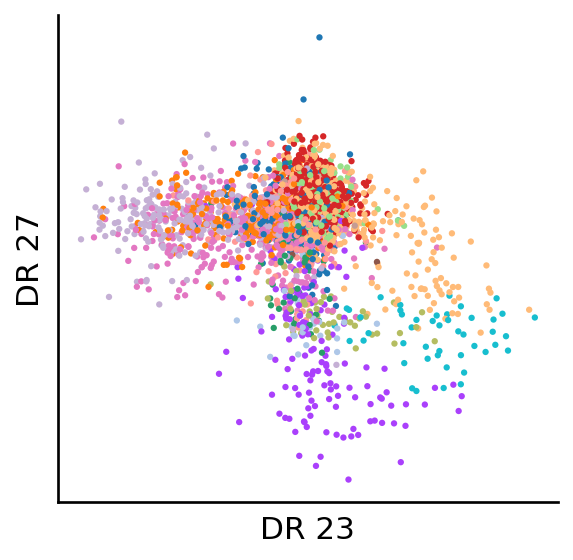

Delta


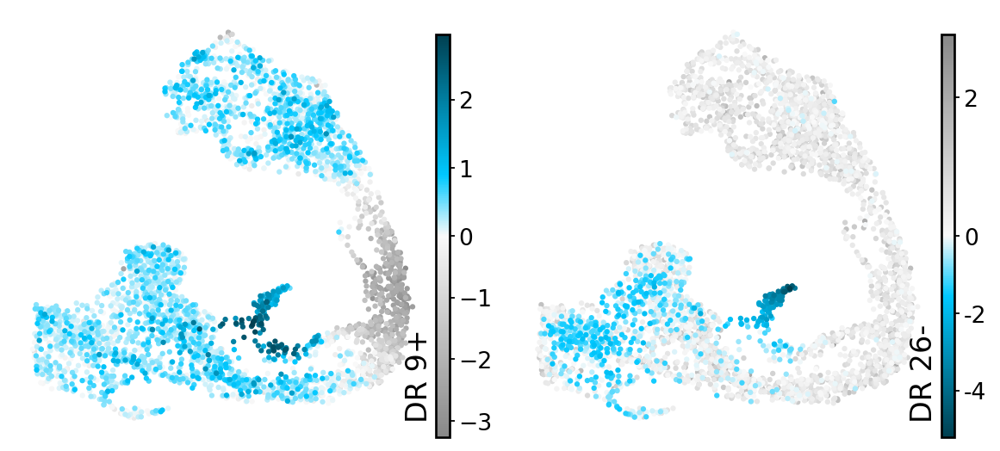

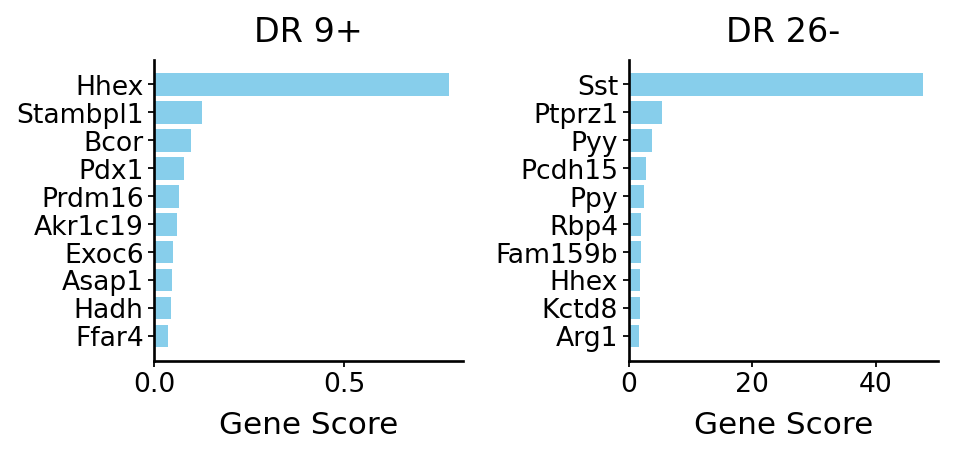

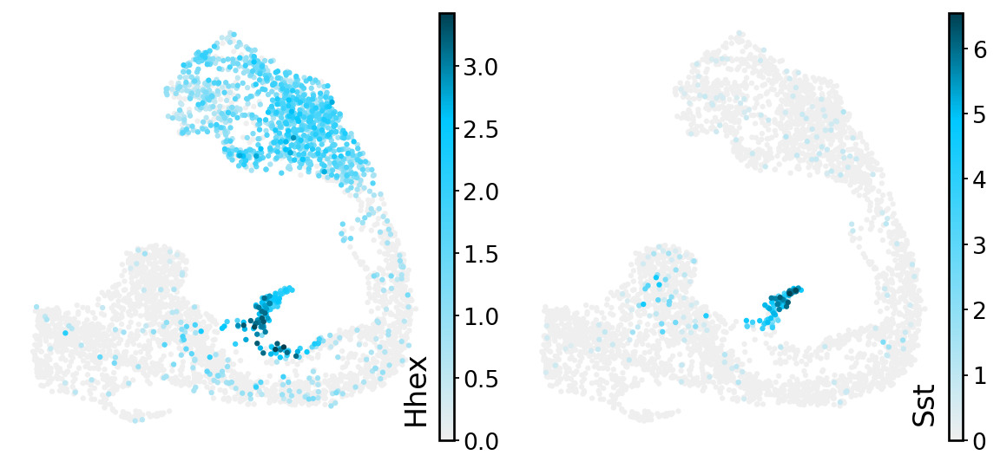

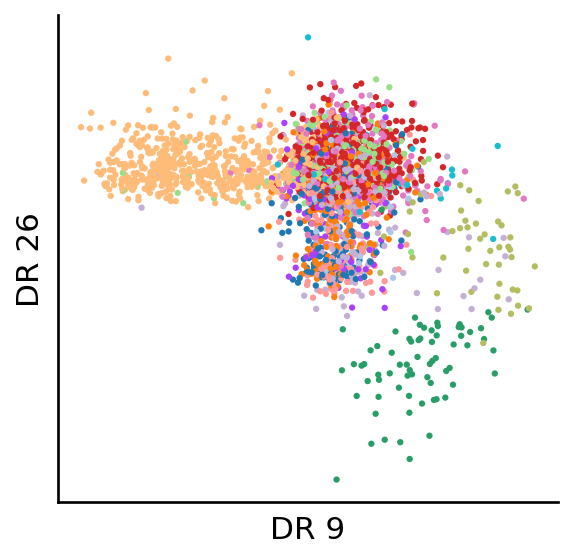

In [29]:
dir_name = output_dir
relevant_dims = [
    (['DR 8+', 'DR 4+'], ["Tmem27", "Gcg"], "Alpha"),
    (['DR 23-', 'DR 1+', 'DR 11-'], ["Mnx1", "Sytl4", "Ins1"], "Beta"),
    (['DR 23+', 'DR 27-'], ["Cdkn1a", "Ghrl"], "Epsilon"),
    (['DR 9+', 'DR 26-'], ["Hhex", "Sst"], "Delta"),
]
for dims, genes, title in relevant_dims:
    print(title)
    #############
    fig = drvi.utils.pl.plot_latent_dims_in_umap(embed, directional=True, ncols=4, show=False, wspace=0.1, hspace=0.25, color_bar_rescale_ratio=0.95,
                                                 dim_subset=dims)
    fig.savefig(dir_name / f'drvi_interesting_latents_for_{title}_on_umap.pdf', bbox_inches='tight', dpi=200)
    plt.show()
    #############
    fig = drvi.utils.pl.show_top_differential_vars(traverse_adata, dim_subset=dims, key="combined_score", score_threshold=0.0, show=False)
    fig.savefig(dir_name / f'drvi_interesting_latents_for_{title}_interpretability.pdf', bbox_inches='tight', dpi=200)
    plt.show()
    #############
    fig = sc.pl.embedding(
        adata,
        "X_umap_drvi",
        color=genes,
        cmap=drvi.utils.pl.cmap.saturated_just_sky_cmap,
        show=False,
        frameon=False,
        return_fig=True,
        wspace=0.1,
    )
    for ax in fig.axes:
        ax.text(0.92, 0.05, ax.get_title(), size=15, ha="left", color="black", rotation=90, transform=ax.transAxes)
        ax.set_title("")
    fig.savefig(dir_name / f'drvi_interesting_latents_for_{title}_relevant_genes_umap.pdf', bbox_inches='tight', dpi=200)
    plt.show()
    #############
    dim_pairs = [
        (int(np.argmax(embed.var['title'] == d1[:-1])), int(np.argmax(embed.var['title'] == d2[:-1]))) for d1, d2 in zip(dims[:-1], dims[1:])
    ]
    fig = sc.pl.embedding(embed, 'qz_mean', dimensions=dim_pairs, return_fig=True, color=['clusters_fine'], ncols=1, show=False, legend_loc=None, title=[""]*len(dim_pairs), hspace=0.1)
    for ax in fig.axes:
        xlbl = str(ax.xaxis.get_label().get_text())
        ylbl = str(ax.yaxis.get_label().get_text())
        # print(xlbl, ylbl)
        if 'qz_mean' in xlbl:
            ax.set_xlabel(embed.var.iloc[int(xlbl.split('qz_mean')[-1])-1]['title'])
        if 'qz_mean' in ylbl:
            ax.set_ylabel(embed.var.iloc[int(ylbl.split('qz_mean')[-1])-1]['title'])
    fig.savefig(dir_name / f'drvi_interesting_latents_for_{title}_scatterplot.pdf', bbox_inches='tight', dpi=200)
    plt.show()

# Identify cell-cycle dimensions

In [30]:
set_font_in_rc_params()

In [31]:
corr_scores = defaultdict(dict)
mi_scores = defaultdict(dict)

In [32]:
for method_name, embed in embeds.items():
    print(method_name)
    for col, col_type in [
        ('S_score', 'continuous'),
        ('G2M_score', 'continuous'),
    ]:
        if col_type == 'continuous':
            if col not in corr_scores[method_name]:
                embedding_array = embed.X
                n_vars = embed.n_vars
                corr_score = np.abs(stats.spearmanr(embedding_array, embed.obs[col]).statistic[:n_vars, n_vars:]).flatten()
                corr_scores[method_name][col] = corr_score
            print(f"{col} Max Correlation score: ", corr_scores[method_name][col].max())
            if col not in mi_scores[method_name]:
                embedding_array = embed.X
                n_vars = embed.n_vars
                mi_score = mutual_info_regression(embedding_array, embed.obs[col]).flatten()
                mi_scores[method_name][col] = mi_score
            print(f"{col} Max MI score: ", mi_scores[method_name][col].max())

DRVI
S_score Max Correlation score:  0.5982018878787937
S_score Max MI score:  0.5235233091168867
G2M_score Max Correlation score:  0.45287647656651453
G2M_score Max MI score:  0.47495398201912575
DRVI-IK
S_score Max Correlation score:  0.6224548714679214
S_score Max MI score:  0.2874035169483209
G2M_score Max Correlation score:  0.4031438096251796
G2M_score Max MI score:  0.24026646011542496
scVI
S_score Max Correlation score:  0.592546178706299
S_score Max MI score:  0.3252103337390295
G2M_score Max Correlation score:  0.4424018392398196
G2M_score Max MI score:  0.20223313378864383
PCA
S_score Max Correlation score:  0.6554953517674452
S_score Max MI score:  0.34721237317488196
G2M_score Max Correlation score:  0.41619924640440487
G2M_score Max MI score:  0.2885967667539715
ICA
S_score Max Correlation score:  0.3641162507988113
S_score Max MI score:  0.32131552986387835
G2M_score Max Correlation score:  0.26875560544069144
G2M_score Max MI score:  0.349824819353441
MOFA
S_score Max C

In [33]:
# calculate DRVI improvements
0.5235233091168858 / 0.3534779256318572, 0.47495746282584506 / 0.45862906327157127

(1.4810636567504607, 1.0356026271815337)

DRVI
DRVI-IK
scVI
PCA
ICA
MICHIGAN-opt
TCVAE-opt
MOFA


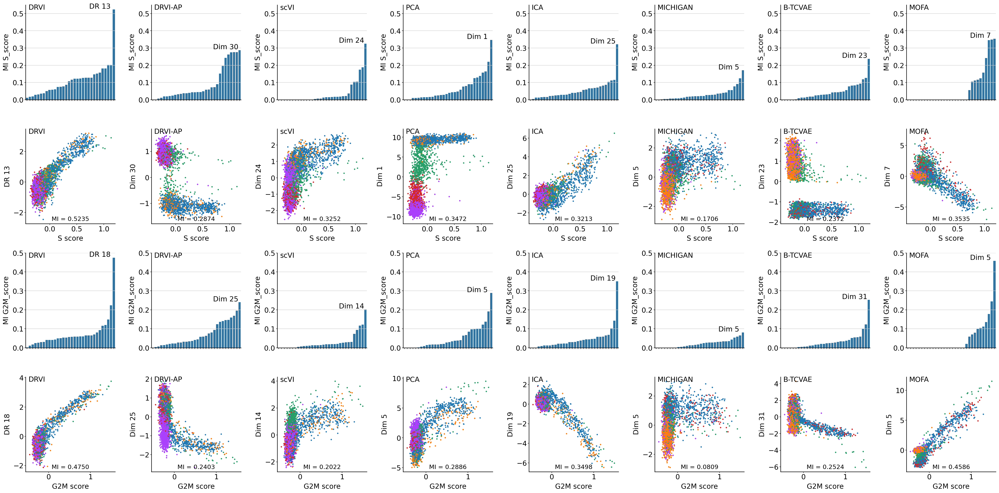

In [34]:
num_methods = len(embeds)
fig, axes = plt.subplots(nrows=4, ncols=num_methods, figsize=(4 * num_methods, 4 * 4))

for idx, method_name in enumerate(methods_to_plot):
    embed = embeds[method_name]
    print(method_name)
    p1, p2 = 'S_score', 'G2M_score'
    dim_pair = [int(mi_scores[method_name][p1].argmax()),
                int(mi_scores[method_name][p2].argmax())]
    
    plot_df = pd.DataFrame({
        'Coarse cell-type': embed.obs['clusters_coarse'],
        p1: embed.obs[p1],
        p2: embed.obs[p2],
        f'dim_1': embed.X[:, dim_pair[0]].flatten(),
        f'dim_2': embed.X[:, dim_pair[1]].flatten(),
    })
    
    # Scatter plot for p1
    ax1 = axes[1, idx]
    sns.scatterplot(data=plot_df, x=p1, y='dim_1', s=10, hue='Coarse cell-type', linewidth=0, alpha=1., ax=ax1, rasterized=True)
    ax1.set(xlabel='S score', ylabel=f'Dim {1 + dim_pair[0]}' if method_name != 'DRVI' else embed.var.iloc[dim_pair[0]]['title'])
    ax1.text(0.03, 0.95, pretify_method_name(method_name), size=16, ha='left', color='black', rotation=0, transform=ax1.transAxes)
    ax1.text(0.5, 0.03, f"MI = {mi_scores[method_name][p1][dim_pair[0]]:.4f}", size=14, ha='center', color='black', rotation=0, transform=ax1.transAxes)
    ax1.legend([], [], frameon=False)
    ax1.grid(False)
    
    # Scatter plot for p2
    ax2 = axes[3, idx]
    sns.scatterplot(data=plot_df, x=p2, y='dim_2', s=10, hue='Coarse cell-type', linewidth=0, alpha=1., ax=ax2, rasterized=True)
    ax2.set(xlabel='G2M score', ylabel=f'Dim {1 + dim_pair[1]}' if method_name != 'DRVI' else embed.var.iloc[dim_pair[1]]['title'])
    ax2.text(0.03, 0.95, pretify_method_name(method_name), size=16, ha='left', color='black', rotation=0, transform=ax2.transAxes)
    ax2.text(0.5, 0.03, f"MI = {mi_scores[method_name][p2][dim_pair[1]]:.4f}", size=14, ha='center', color='black', rotation=0, transform=ax2.transAxes)
    ax2.legend([], [], frameon=False)
    ax2.grid(False)
    
    # Bar plot for p1 MI scores
    ax3 = axes[0, idx]
    mi_scores_p1_sorted = np.sort(mi_scores[method_name][p1])
    max_dim_p1 = mi_scores[method_name][p1].argmax()
    sns.barplot(x=range(len(mi_scores_p1_sorted)), y=mi_scores_p1_sorted, ax=ax3)
    ax3.set(xlabel='', ylabel=f'MI {p1}')
    ax3.set_xticklabels([])  # Remove x-axis labels
    ax3.text(0.03, 0.95, pretify_method_name(method_name), size=16, ha='left', color='black', rotation=0, transform=ax3.transAxes)
    ax3.text(len(mi_scores_p1_sorted) - 6, mi_scores_p1_sorted[-1]-0.002, 
             f'Dim {max_dim_p1 + 1}' if method_name != 'DRVI' else embed.var.iloc[max_dim_p1]['title'], 
             ha='center', va='bottom', color='black')
    ax3.set_ylim(0, 0.55)

    # Bar plot for p2 MI scores
    ax4 = axes[2, idx]
    mi_scores_p2_sorted = np.sort(mi_scores[method_name][p2])
    max_dim_p2 = mi_scores[method_name][p2].argmax()
    sns.barplot(x=range(len(mi_scores_p2_sorted)), y=mi_scores_p2_sorted, ax=ax4)
    ax4.set(xlabel='', ylabel=f'MI {p2}')
    ax4.set_xticklabels([])  # Remove x-axis labels
    ax4.text(0.03, 0.95, pretify_method_name(method_name), size=16, ha='left', color='black', rotation=0, transform=ax4.transAxes)
    ax4.text(len(mi_scores_p2_sorted) - 6, mi_scores_p2_sorted[-1]-0.002, 
             f'Dim {max_dim_p2 + 1}' if method_name != 'DRVI' else embed.var.iloc[max_dim_p2]['title'], 
             ha='center', va='bottom', color='black')
    ax4.set_ylim(0, 0.5)

# Adjust layout and show the plot
plt.tight_layout()
dir_name = output_dir
dir_name.mkdir(parents=True, exist_ok=True)
fig.savefig(dir_name / f'cell_cycle_mi_for_all_methods.pdf', bbox_inches='tight', dpi=300)
plt.show()


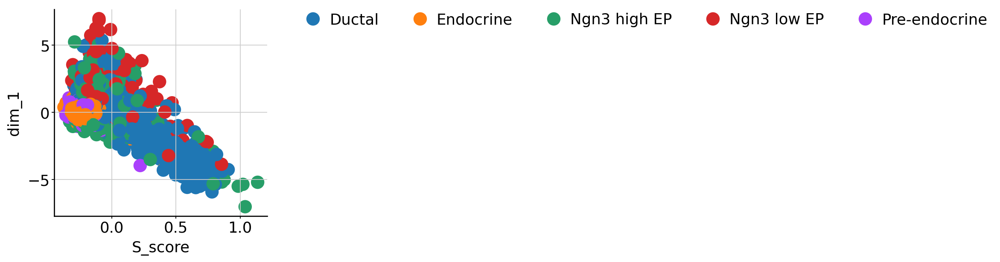

In [35]:
ax = sns.scatterplot(data=plot_df, x=p1, y='dim_1', s=200, hue='Coarse cell-type', linewidth=0, alpha=1., rasterized=True)
plt.legend(ncol=5, bbox_to_anchor=(1.1, 1.05))
plt.savefig(dir_name / f'cell_cycle_mi_for_all_methods_legend.pdf', bbox_inches='tight', dpi=300)
plt.show()

DRVI
DRVI-IK
scVI
PCA
ICA
MICHIGAN-opt
TCVAE-opt
MOFA


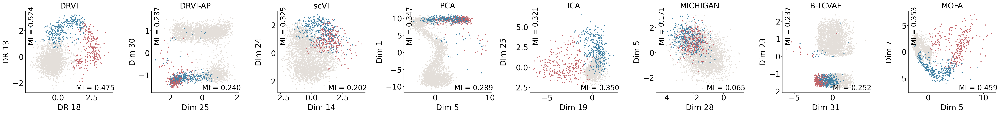

In [36]:
set_font_in_rc_params(22)
num_methods = len(embeds)
fig, axes = plt.subplots(nrows=1, ncols=num_methods, figsize=(5 * num_methods, 5))
cycling_palette = {'Non-cycling': '#E4DFDA', 'G2M': '#C1666B', 'S': '#4281A4'}

for idx, method_name in enumerate(methods_to_plot):
    embed = embeds[method_name]
    print(method_name)
    p1, p2 = 'S_score', 'G2M_score'
    dim_pair = [int(mi_scores[method_name][p1].argmax()),
                int(mi_scores[method_name][p2].argmax())]
    if dim_pair[0] == dim_pair[1]:
        dim_pair[1] = np.ma.masked_array(mi_scores[method_name][p2], np.identity(mi_scores[method_name][p2].shape[0])[dim_pair[1]]).argmax()
    
    plot_df = pd.DataFrame({
        'Coarse cell-type': embed.obs['clusters_coarse'],
        p1: embed.obs[p1],
        p2: embed.obs[p2],
        f'dim_0': embed.X[:, dim_pair[0]].flatten(),
        f'dim_1': embed.X[:, dim_pair[1]].flatten(),
    })
    
    # Define the cell cycle status
    plot_df['Cell Cycle Status'] = 'Non-cycling'
    plot_df.loc[(plot_df[p2] > 0.2) & (plot_df[p2] > plot_df[p1]), 'Cell Cycle Status'] = 'G2M'
    plot_df.loc[(plot_df[p1] > 0.2) & (plot_df[p1] >= plot_df[p2]), 'Cell Cycle Status'] = 'S'
    plot_df['Cell Cycle Status'] = pd.Categorical(plot_df['Cell Cycle Status'], ['Non-cycling', 'G2M', 'S'], ordered=True)
    plot_df['is_cycling'] = ~(plot_df['Cell Cycle Status'] == 'Non-cycling')
    plot_df.sort_values(['is_cycling'], inplace=True)
    # Scatter plot for dim_pair[1] vs dim_pair[0] with cell cycle status color
    ax = axes[idx]
    sns.scatterplot(data=plot_df, x='dim_1', y='dim_0', s=10, hue='Cell Cycle Status', linewidth=0, alpha=1., ax=ax, palette=cycling_palette, rasterized=True)
    ax.set(xlabel=f'Dim {1 + dim_pair[1]}' if method_name != 'DRVI' else embed.var.iloc[dim_pair[1]]['title'], 
           ylabel=f'Dim {1 + dim_pair[0]}' if method_name != 'DRVI' else embed.var.iloc[dim_pair[0]]['title'])
    ax.set_title(pretify_method_name(method_name))
    ax.text(0.8, 0.03, f"MI = {mi_scores[method_name][p2][dim_pair[1]]:.3f}", size=20, ha='center', color='black', rotation=0, transform=ax.transAxes)
    ax.text(0.07, 0.6, f"MI = {mi_scores[method_name][p1][dim_pair[0]]:.3f}", size=20, ha='center', color='black', rotation=90, transform=ax.transAxes)
    ax.legend([], [], frameon=False)
    ax.grid(False)

# Adjust layout and show the plot
plt.tight_layout()
dir_name = output_dir
fig.savefig(dir_name / f'cell_cycle_pair_for_all_methods.pdf', bbox_inches='tight', dpi=300)
plt.show()

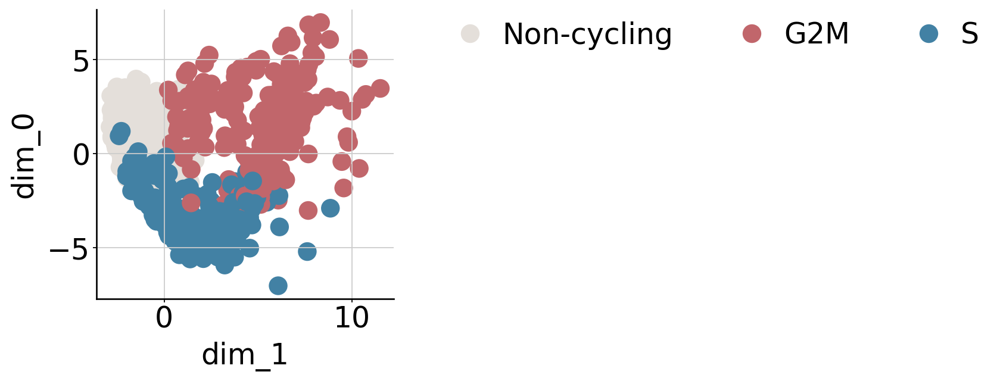

In [37]:
ax = sns.scatterplot(data=plot_df, x='dim_1', y='dim_0', s=200, hue='Cell Cycle Status', linewidth=0, alpha=1., palette=cycling_palette, rasterized=True)
plt.legend(ncol=5, bbox_to_anchor=(1.1, 1.05))
plt.savefig(dir_name / f'cell_cycle_pair_for_all_methods_legend.pdf', bbox_inches='tight', dpi=300)
plt.show()

In [38]:
plt.rcParams.update(original_params)